In [1]:
import numpy as np
import numpy.linalg as npl
import scipy.interpolate as scpi
import matplotlib.pyplot as plt

import import_ipynb
from Polynome2p1_avecArgumentsF import *
import Fonctions_Test as FT

importing Jupyter notebook from Polynome2p1_avecArgumentsF.ipynb
importing Jupyter notebook from Polynome2p1.ipynb
importing Jupyter notebook from Fonctions_Test.ipynb


In [2]:
# Schema 
def DF_amont(U0,T,dt,dx,c):
    J = int(1/dx) - 1
    t = 0
    U = np.copy(U0)
    while t < T:
        Taum = np.concatenate(([U[-1]],U[:-1]))
        U = U - c*dt/dx * (U - Taum)
        t += dt
    return U

In [3]:
# Traitement de la donnée initiale
def gauss(x,h,origin,sigma):
    x = x*h+origin
    return np.exp(-((x-0.5)**2)/(2*sigma))/(np.sqrt(2*np.pi*sigma**2))

def paquet(x,h,origin,sigma,k):
    return gauss(x,h,origin,sigma)*np.sin(2*k*np.pi*x)

def creneau(x,h,origin,start,end):
    x = (x+origin)*h
    return 1 *(x>=start*h) + 1*(x<=end*h)

def u0(x,h,origin):
    x = (x+origin)*h
    return np.cos(np.pi*x)**2+1

# Test de base sur $cos(\pi x)^2 +1$

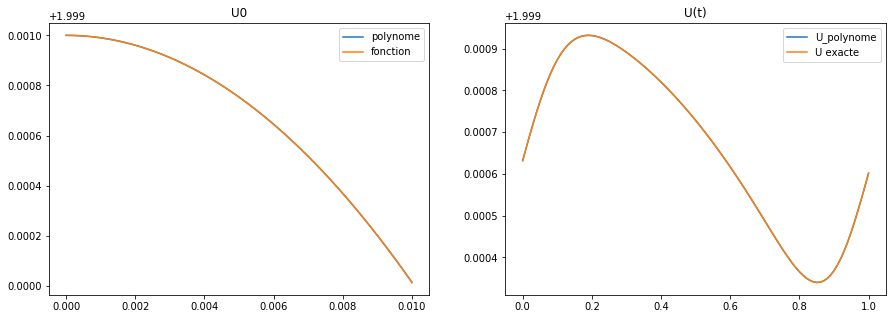

5.434425465420574e-15


In [182]:
#Parametres du pb
n_points = 100 + 1
x = np.linspace(0,1,n_points)
dx = 1/(n_points-1) 
CFL = 1/2
c = 1
dt = dx*CFL/c
T = 2

#Parametres interpolation
p = 10
f = u0
h = dx
argf = [0] 
epsilon = 1e-5

px,fx,nbiter =  approxh(x,p,f,h,argf,epsilon,init=None,s=1)
U0 = f(x,h,*argf)

U = DF_amont(px,T,dt,dx,c)
Uex = DF_amont(U0,T,dt,dx,c)

plt.figure(figsize=(15,5))

plt.subplot(1,2,1)
plt.plot(x*h,px,label="polynome")
plt.plot(x*h,U0,label="fonction")
plt.legend()
plt.title("U0")

plt.subplot(1,2,2)
plt.plot(x,U,label="U_polynome")
plt.plot(x,Uex,label="U exacte")
plt.legend()
plt.title("U(t)")
plt.show()

print(npl.norm(U-Uex))


In [5]:
if False : 
    import os
    os.mkdir('./tmp/')

In [6]:
import imageio
import os
from IPython.display import HTML
from IPython.display import Image

# Animation
def animation2(init_u,f,argf,top,bottom):
    n_points = 100 + 1
    x = np.linspace(0,1,n_points)
    dx = 1/(n_points-1) 
    CFL = 1/2
    c = 1
    dt = dx*CFL/c
    T = 1
    nb_pas = int(T/dt)   
    h = dx
    if init_u == 1 : 
        U = f(x,h,*argf)
    else : 
        p = 2
        epsilon = 1e-5
        U,fx,nb_iter = approxh(x,p,f,h,argf,epsilon,init=None,s=1)

    for i in range(nb_pas):
        U = DF_amont(U,dt,dt,dx,c)
        plt.plot(x,U)
        plt.ylim(top=top)
        plt.ylim(bottom=bottom)
        plt.savefig("tmp/amont" + str(i) + ".png")
        plt.clf()

    images = []

    for i in range(nb_pas):
        images.append(imageio.imread("tmp/amont" + str(i) + ".png"))
    imageio.mimsave('animation_2.gif', images)

    with open('animation_2.gif','rb') as file:
        display(Image(file.read()))

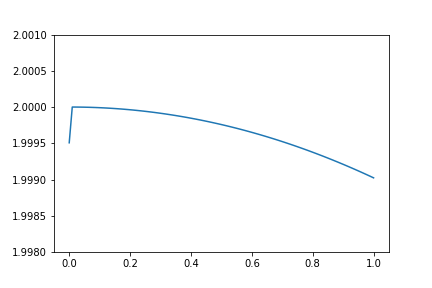

In [7]:
top = 2.001
bottom = 1.998

argf = [0]
f = u0
animation2(1,f,argf,top,bottom)

### Test de base pour la gaussienne

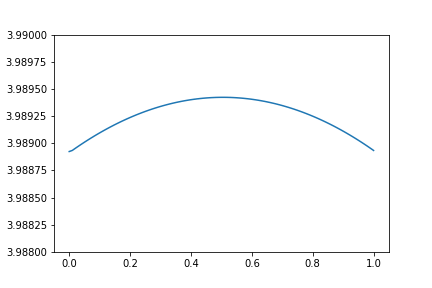

In [8]:
top = 3.99
bottom = 3.988

argf = [0.495,1/10]
f = gauss
animation2(0,f,argf,top,bottom)

# Tests sur plusieurs cellules

### Juste avec des conditions périodiques

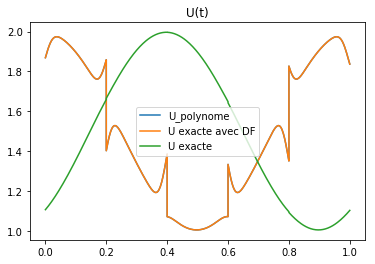

In [9]:
#Donnees du pb
c = 1
T = 2

#Parametres de discretisation
cells_num = 5
n_points = 100 + 1
x = np.linspace(0,1,n_points)
dx = 1/(n_points-1) 
CFL = 1/2
dt = dx*CFL/c

#Parametres interpolation
p = 5
f = u0
h = 1/cells_num
epsilon = 1e-5

U = np.zeros(cells_num*n_points)
Uex = np.zeros(cells_num*n_points)
x_cells = np.zeros(cells_num*n_points)

for i in range (cells_num) :
    origin = i
    x_cell = (x+origin)*h
    x_cells[i*n_points:(i+1)*n_points] = x_cell
    argf = [origin] 
    
    px,fx,nbiter =  approxh(x,p,f,h,argf,epsilon,init=None,s=1)
    U0 = f(x,h,*argf)

    U_cell = DF_amont(px,T,dt,dx,c)
    Uex_cell = DF_amont(U0,T,dt,dx,c)
    U[i*n_points:(i+1)*n_points] = U_cell
    Uex[i*n_points:(i+1)*n_points] = Uex_cell

    #plt.figure(figsize=(15,5))
    """plt.subplot(1,2,1)
    plt.plot(x_cell,px,label="polynome")
    plt.plot(x_cell,U0_cell,label="fonction")
    plt.legend()
    plt.title("U0")

    plt.subplot(1,2,2)
    plt.plot(x_cell,U_cell,label="U_polynome")
    plt.plot(x_cell,Uex_cell,label="U exacte")
    plt.legend()
    plt.title("U(t)")
    plt.show()"""
    #print(npl.norm(U-Uex))

        
U1 = f(x_cells,1,0)
U1 = DF_amont(U1,T,dt,dx,c)
plt.plot(x_cells,U,label="U_polynome")
plt.plot(x_cells,Uex,label="U exacte avec DF")
plt.plot(x_cells,U1,label="U exacte")
plt.legend()
plt.title("U(t)")
plt.show()

C:\Users\gerie\Anaconda3\lib\site-packages\numpy\lib\polynomial.py:732: RuntimeWarning: invalid value encountered in add
  val = a1 + a2
C:\Users\gerie\Anaconda3\lib\site-packages\numpy\lib\polynomial.py:1223: RuntimeWarning: divide by zero encountered in true_divide
  return poly1d(self.coeffs/other)


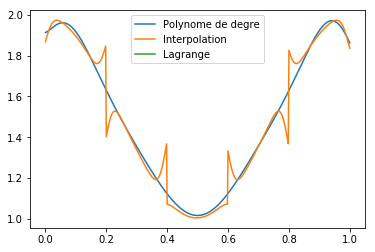

In [10]:
#pour de la reconstruction
import scipy.interpolate as spi

a = np.polyfit(x_cells,U,10)
poly = 0
for i in range (len(a)):
    poly += a[len(a)-i-1] * x_cells**i

    
interp = spi.interp1d(x_cells,U)
lagrange = spi.lagrange(x_cells,U)

plt.plot(x_cells,poly,label="Polynome de degre")
plt.plot(x_cells, interp(x_cells),label="Interpolation")
plt.plot(x_cells, lagrange(x_cells),label="Lagrange")
plt.legend()
plt.show()

### *Test pour une fonction identique sur toutes les cellules*

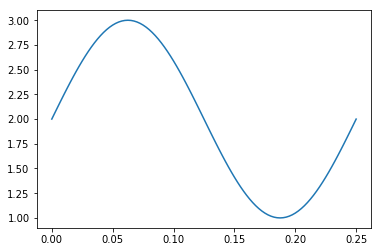

In [11]:
def u0(x,h,origin,cells_num):
    x = (x+origin)*h
    k = 1
    return np.sin(2*np.pi*x*k*cells_num) + 2 

plt.plot((x+0)*1/4,u0(x,1/4,0,4))

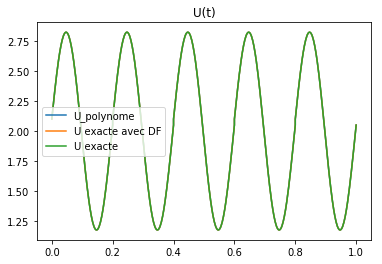

In [12]:
#Donnees du pb
c = 1
T = 2

#Parametres de discretisation
cells_num = 5
n_points = 100 + 1
x = np.linspace(0,1,n_points)
dx = 1/(n_points-1) 
CFL = 1/2
dt = dx*CFL/c

#Parametres interpolation
p = 10
f = u0
h = 1/cells_num
epsilon = 1e-5

U = np.zeros(cells_num*n_points)
Uex = np.zeros(cells_num*n_points)
x_cells = np.zeros(cells_num*n_points)

for i in range (cells_num) :
    origin = i
    x_cell = (x+origin)*h
    x_cells[i*n_points:(i+1)*n_points] = x_cell
    argf = [origin,cells_num] 
    
    px,fx,nbiter =  approxh(x,p,f,h,argf,epsilon,init=None,s=1)
    U0 = f(x,h,*argf)

    U_cell = DF_amont(px,T,dt,dx,c)
    Uex_cell = DF_amont(U0,T,dt,dx,c)
    U[i*n_points:(i+1)*n_points] = U_cell
    Uex[i*n_points:(i+1)*n_points] = Uex_cell
    
   #print(npl.norm(U-Uex))

U1 = f(x_cells,1,0,cells_num)
U1 = DF_amont(U1,T,dt,dx,c)
plt.plot(x_cells,U,label="U_polynome")
plt.plot(x_cells,Uex,label="U exacte avec DF")
plt.plot(x_cells,U1,label="U exacte")
plt.legend()
plt.title("U(t)")
plt.show()

In [13]:
import imageio
import os
from IPython.display import HTML
from IPython.display import Image

# Animation
def animation3(init_u,top,bottom):
    #Donnees du pb
    c = 1
    T = 2
    #Parametres de discretisation
    cells_num = 5
    n_points = 100 + 1
    x = np.linspace(0,1,n_points)
    dx = 1/(n_points-1) 
    CFL = 1/2
    dt = dx*CFL/c
    #Parametres interpolation
    p = 10
    f = u0
    h = 1/cells_num
    epsilon = 1e-5
    
    # init
    U = np.zeros(cells_num*n_points)
    x_cells = np.zeros(cells_num*n_points)
    for i in range (cells_num) :
        origin = i
        x_cell = (x+origin)*h
        x_cells[i*n_points:(i+1)*n_points] = x_cell
        argf = [origin,cells_num] 
        if init_u == 1 : 
            U[i*n_points:(i+1)*n_points] = f(x,h,*argf)
        else : 
            p = 5
            epsilon = 1e-5
            U[i*n_points:(i+1)*n_points],fx,nb_iter = approxh(x,p,f,h,argf,epsilon,init=None,s=1)
    # iterations en temps
    for t in range(n_points):
        for i in range (cells_num) :          
            U[i*n_points:(i+1)*n_points] = DF_amont(U[i*n_points:(i+1)*n_points],dt,dt,dx,c)
        
        plt.plot(x_cells,U)
        plt.ylim(top=top)
        plt.ylim(bottom=bottom)
        plt.savefig("tmp/amont" + str(t) + ".png")
        plt.clf()

        
        
    images = []

    for i in range(n_points):
        images.append(imageio.imread("tmp/amont" + str(i) + ".png"))
    imageio.mimsave('animation_3.gif', images)

    with open('animation_3.gif','rb') as file:
        display(Image(file.read()))

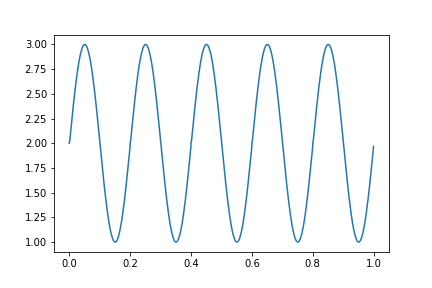

In [14]:
top = 3.1
bottom = 0.9

animation3(1,top,bottom)

C:\Users\gerie\Anaconda3\lib\site-packages\numpy\lib\polynomial.py:732: RuntimeWarning: invalid value encountered in add
  val = a1 + a2
C:\Users\gerie\Anaconda3\lib\site-packages\numpy\lib\polynomial.py:1223: RuntimeWarning: divide by zero encountered in true_divide
  return poly1d(self.coeffs/other)


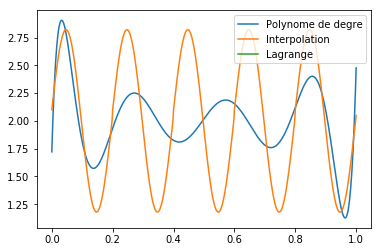

In [15]:
#pour la reconstruction
import scipy.interpolate as spi

a = np.polyfit(x_cells,U,10)
poly = 0
for i in range (len(a)):
    poly += a[len(a)-i-1] * x_cells**i

    
interp = spi.interp1d(x_cells,U)
lagrange = spi.lagrange(x_cells,U)

plt.plot(x_cells,poly,label="Polynome de degre")
plt.plot(x_cells, interp(x_cells),label="Interpolation")
plt.plot(x_cells, lagrange(x_cells),label="Lagrange")
plt.legend()
plt.show()

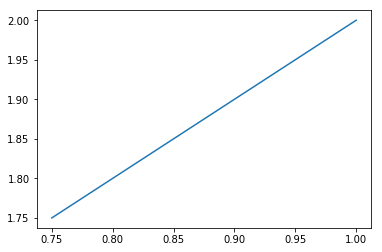

In [16]:
def affine(x,h,a):
    x = (x+a)*h
    return x+1

x = np.linspace(0,1,10)
h = 1/4
a = 3
plt.plot(x*h+a*h,affine(x,h,a))

# Essai avec conditions périodiques sur les bords 0 et 1 seulement

In [6]:
def u0(x,h,origin):
    x = (x+origin)*h
    return np.cos(np.pi*x)**2+1

In [7]:
# Schema 
def DF_amont_2(U0,dt,dx,c,cond):
    U = np.copy(U0)
    Taum = np.concatenate(([cond],U[:-1]))
    U = U - c*dt/dx * (U - Taum)
    return U

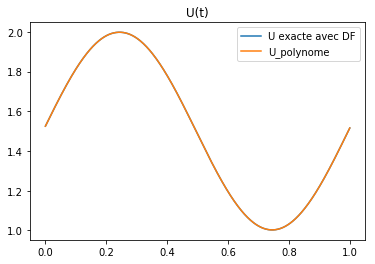

In [19]:
#Donnees du pb
c = 1
T = 1.23

#Parametres de discretisation
cells_num = 5
n_points = 100 + 1
x = np.linspace(0,1,n_points)
dx = 1/(n_points-1) 
CFL = 1/2
dt = dx*CFL/c

#Parametres interpolation
p = 5
f = u0
h = 1/cells_num
epsilon = 1e-5

U = np.zeros(cells_num*n_points)
Uex = np.zeros(cells_num*n_points)
U0 = np.zeros(cells_num*n_points)
U0ex = np.zeros(cells_num*n_points)
x_cells = np.zeros(cells_num*n_points)

#init
for i in range (cells_num) :
    origin = i
    x_cell = (x+origin)*h
    x_cells[i*n_points:(i+1)*n_points] = x_cell
    argf = [origin] 
    Uex[i*n_points:(i+1)*n_points] = f(x,h,*argf)
    U[i*n_points:(i+1)*n_points],fx,nb_iter = approxh(x,p,f,h,argf,epsilon,init=None,s=1)
    U0 = np.copy(U)
    U0ex = np.copy(Uex)
    
#en temps
for t in range (int(T//dt)):
    for i in range (cells_num) :
        if i == 0 :
            cond = U0[-1]
            condex = U0ex[-1]
        else : 
            cond = U0[i*n_points-2]
            condex = U0ex[i*n_points-2]
           
        U_cell = DF_amont_2(U[i*n_points:(i+1)*n_points],dt,dx,c,cond)
        Uex_cell = DF_amont_2(Uex[i*n_points:(i+1)*n_points],dt,dx,c,condex)

        U0[i*n_points:(i+1)*n_points]  = U[i*n_points:(i+1)*n_points]
        U0ex[i*n_points:(i+1)*n_points]  = Uex[i*n_points:(i+1)*n_points]
        
        U[i*n_points:(i+1)*n_points] = U_cell
        Uex[i*n_points:(i+1)*n_points] = Uex_cell
        

        
U1 = f(x_cells,1,0)
U1 = DF_amont(U1,T,dt,dx,c)
plt.plot(x_cells,Uex,label="U exacte avec DF")
plt.plot(x_cells,U,label="U_polynome")
#plt.plot(x_cells,U1,label="U exacte")
plt.legend()
plt.savefig("advection.png",format='png')
plt.title("U(t)")
plt.show()

In [20]:
from IPython.display import HTML
from IPython.display import Image

# Animation
def animation3(init_u,top,bottom):
    #Donnees du pb
    c = 1
    T = 2
    #Parametres de discretisation
    cells_num = 5
    n_points = 100 + 1
    x = np.linspace(0,1,n_points)
    dx = 1/(n_points-1) 
    CFL = 1/2
    dt = dx*CFL/c
    #Parametres interpolation
    p = 10
    f = u0
    h = 1/cells_num
    epsilon = 1e-5
    
    #init
    for i in range (cells_num) :
        origin = i
        x_cell = (x+origin)*h
        x_cells[i*n_points:(i+1)*n_points] = x_cell
        argf = [origin] 
        if init_u == 0 : 
            U[i*n_points:(i+1)*n_points] = f(x,h,*argf)
        else : 
            U[i*n_points:(i+1)*n_points],fx,nb_iter = approxh(x,p,f,h,argf,epsilon,init=None,s=1)
        U0 = np.copy(U)

    #en temps
    for t in range (int(T//dt)):
        for i in range (cells_num) :
            if i == 0 :
                cond = U0[-1]
                condex = U0ex[-1]
            else : 
                cond = U0[i*n_points-2]
                condex = U0ex[i*n_points-2]

            U_cell = DF_amont_2(U[i*n_points:(i+1)*n_points],dt,dx,c,cond)
            U0[i*n_points:(i+1)*n_points]  = U[i*n_points:(i+1)*n_points]
            U[i*n_points:(i+1)*n_points] = U_cell
        
        plt.plot(x_cells,U)
        plt.ylim(top=top)
        plt.ylim(bottom=bottom)
        plt.savefig("tmp/amont" + str(t) + ".png")
        plt.clf()

        
        
    images = []

    for t in range(int(T//dt)):
        images.append(imageio.imread("tmp/amont" + str(t) + ".png"))
    imageio.mimsave('animation_3.gif', images)

    with open('animation_3.gif','rb') as file:
        display(Image(file.read()))

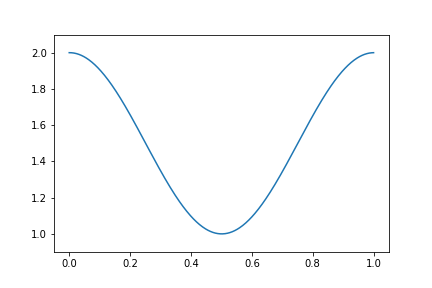

In [21]:
top = 2.1
bottom = 0.9

animation3(1,top,bottom)

In [22]:
def pourLagrange(x_cells,U_cells):
    x = []
    U = []
    for i in range (len(x_cells)-1):
        if x_cells[i] != x_cells[i+1] : 
            x.append(x_cells[i])
            U.append(U_cells[i])
    return x,U

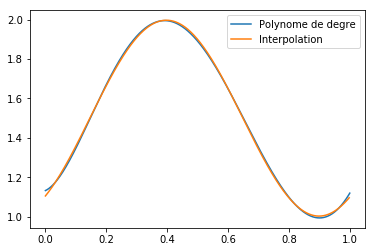

In [23]:
#pour la reconstruction
import scipy.interpolate as spi

x1,U1 = pourLagrange(x_cells,U) 
interp = spi.interp1d(x1,U1)

ap = np.polyfit(x_cells,U,5)

x = np.linspace(0,1,100001)

poly = np.zeros_like(x)

for i in range (len(ap)):
    poly += ap[len(ap)-i-1] * x**i


plt.plot(x,poly,label="Polynome de degre")
plt.plot(x1, interp(x1),label="Interpolation")
plt.legend()
plt.show()

## Sasn recouvrement de groupes de cellules

In [72]:
from IPython.display import HTML
from IPython.display import Image

# Animation
def animation3(init_u,top,bottom):
    #Donnees du pb
    c = 1
    T = 0.5
    #Parametres de discretisation
    n_cells = 4
    n_points_cell = 100 + 1
    n_points = n_cells * n_points_cell 
    x = np.linspace(0,1,n_points)
    CFL = 1/2
    dx = x[n_points_cell-1]/(n_points_cell-1)
    dt = dx*CFL/c 
    #Parametres interpolation
    p = 10
    f = u0
    h = 1/n_cells
    epsilon = 1e-5
    
    #init
    U = np.zeros(n_points)
    U0 = np.zeros(n_points)
    x_temp = np.linspace(0,1, n_points_cell+1) ##pour avoir un polynome continu
    for i in range (n_cells) :
        argf = [i] #origine
        
        d1,d2 = i*n_points_cell, (i+1)*n_points_cell
    
        if init_u == 0 : 
            U[d1:d2] = f(x_temp[:-1],h,*argf)
        else : 
            U[d1:d2],fx,nb_iter = approxh(x_temp[:-1],p,f,h,argf,epsilon,init=None,s=1)
        U0 = np.copy(U)

    #x2 = np.linspace(0,1,n_points)
    #U = f(x2,1,0)
    #U0 = np.copy(U)
    
    plt.plot(U)
    plt.show()
    #en temp
    for t in range (int(T//dt)):
        for i in range (n_cells) :
            d1,d2 = i*n_points_cell, (i+1)*n_points_cell
            if i == 0 :
                cond = U0[-1]
            else : 
                cond = U0[d1-1]

            U[d1:d2] = DF_amont_2(U[d1:d2],dt,dx,c,cond)
        U0 = np.copy(U)
        
        plt.plot(x,U)
        plt.ylim(top=top)
        plt.ylim(bottom=bottom)
        plt.savefig("tmp/amont" + str(t) + ".png")
        plt.clf()

        
        
    images = []

    for t in range(int(T//dt)):
        images.append(imageio.imread("tmp/amont" + str(t) + ".png"))
    imageio.mimsave('animation_3.gif', images)

    with open('animation_3.gif','rb') as file:
        display(Image(file.read()))

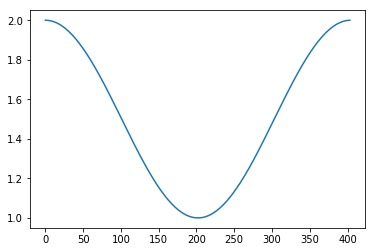

KeyboardInterrupt: 

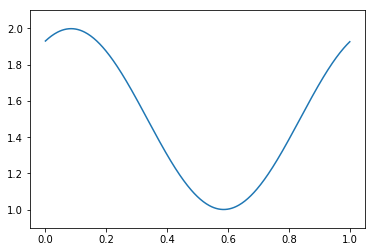

In [73]:
top = 2.1
bottom = 0.9

animation3(1,top,bottom)

In [8]:
def DF2(T,init1):
    #Donnees du pb
    c = 1
    #T = 0.5
    #Parametres de discretisation
    n_cells = 4
    n_points_cell = 100 + 1
    n_points = n_cells * n_points_cell 
    x = np.linspace(0,1,n_points)
    CFL = 1/2
    dx = x[n_points_cell-1]/(n_points_cell-1)
    dt = dx*CFL/c 
    #Parametres interpolation
    p = 3
    f = u0
    h = 1/n_cells
    epsilon = 1e-5
    
    #init
    U = np.zeros(n_points)
    U0 = np.zeros(n_points)
    x_temp = np.linspace(0,1, n_points_cell+1) ##pour avoir un polynome continu
    for i in range (n_cells) :
        argf = [i] #origine
        
        d1,d2 = i*n_points_cell, (i+1)*n_points_cell
    
        if init1 == 1 : 
            U[d1:d2] = f(x_temp[:-1],h,*argf)
            name = "Advection by FD with Initialisation by f"
            name1 = "DFInitialisation_by_f"
        else : 
            U[d1:d2],fx,nb_iter = approxh(x_temp[:-1],p,f,h,argf,epsilon,init=None,s=1)
            name = "Advection by FD with Initialisation by pn"
            name1 = "DFInitialisation_by_pn"
        U0 = np.copy(U)
        U_init = np.copy(U)
    #x2 = np.linspace(0,1,n_points)
    #U = f(x2,1,0)
    #U0 = np.copy(U)
    
    plt.plot(U)
    plt.show()
    #en temp
    n_iter = int(T//dt)
    for t in range (int(T//dt)):
        for i in range (n_cells) :
            d1,d2 = i*n_points_cell, (i+1)*n_points_cell
            if i == 0 :
                cond = U0[-1]
            else : 
                cond = U0[d1-1]

            U[d1:d2] = DF_amont_2(U[d1:d2],dt,dx,c,cond)
        U0 = np.copy(U)
        
       
        
        if t % int(n_iter/4) < 1e-4 or t==0 : 
            plt.plot(x+dx,U,label="T="+str(np.round(dt*t,2)))
            plt.plot(x[::n_points_cell]+dx,U[::n_points_cell],'+r')
    plt.legend()
    plt.title(name)
    plt.savefig("./Images/"+name1+"-p"+str(p)+"epsilon"+str(epsilon)+"-T"+str(T)+".eps",format='eps')
    plt.show()
    return x,U,U_init
    

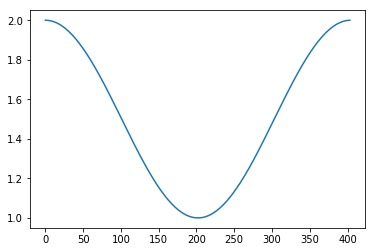

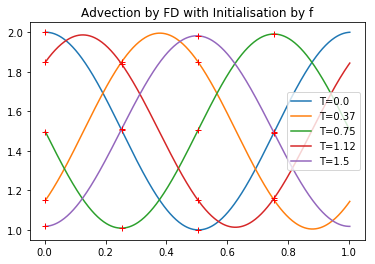

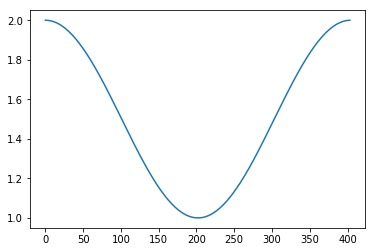

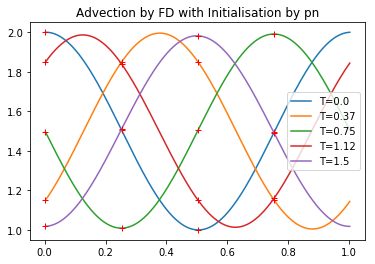

Erreur T=1
1.836610313555656e-08
1.7890653403185297e-09
9.145160563020029e-10
Erreur Init
2.2829832854656571e-07
1.997074106085961e-08
1.1371220818912832e-08


In [20]:
x,U,Uinit = DF2(1.5,1)
x,U2,Uinit2 = DF2(1.5,2)
Uex = u0(x,1,0)

print("Erreur T=1")
print(npl.norm(U-U2))
print(npl.norm(U-U2,np.inf))
print(trapezes(U-U2,x=x))

print("Erreur Init")
print(npl.norm(Uinit-Uinit2))
print(npl.norm(Uinit-Uinit2,np.inf))
print(trapezes(Uinit-Uinit2,x=x))

# En volumes finis

# <font color='red'>A partir d'ici</font>

In [12]:
#Pour schemaavec minmod
def demi2(U0):
    U = np.zeros(len(U0)+2)
    U[1:-1] = U0
    U[0] = U0[-1]
    U[-1] = U0[0]
    x = U[1:-1] - U[:-2]
    y = U[2:] - U[1:-1]
    cond = (x*y>=0)*1
    sign = cond*2-1
    Udemi = U[1:-1] + cond * sign * np.minimum(abs(x),abs(y))/2
    return np.append(Udemi[-1],Udemi)

# Pour schema sans limiteur
## obtient le flux a interface i+1/2
def demi(U0):
    U = np.zeros(len(U0)+1)
    x = U0 - np.roll(U0,1)  
    U[1:] = U0 + x/2
    U[1:] = np.minimum(U[1:],np.maximum(np.maximum(U0,np.roll(U0,1)),np.roll(U0,-1)))
    U[1:] = np.maximum(U[1:],np.minimum(np.minimum(U0,np.roll(U0,1)),np.roll(U0,-1)))
    U[0] = U[-1]
    return U
    
#Iteration en temps
def VF(U0,dt,dx,c):
    U = U0 #- c*dt/dx/2 * (U0 - np.roll(U0,1))
    U2 = demi(U)
    U = U0 - c*dt/dx * (U2[1:] - U2[:-1])
    return U


In [13]:
x = np.linspace(0,5,6)
print(x)
print(demi(x))
np.roll(x,1)

[0. 1. 2. 3. 4. 5.]
[5.  0.  1.5 2.5 3.5 4.5 5. ]


array([5., 0., 1., 2., 3., 4.])

0.001


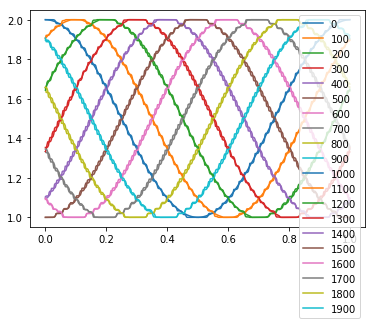

In [163]:
#Parametres du pb
n_points = 400 + 1
x = np.linspace(0,1,n_points)
dx = 1/(n_points-1) 
CFL = 0.4
c = 1
dt = dx*CFL/c
T = 2
print(dt)
x_moy = x[:-1]+(x[1:]-x[:-1])/2
#Donnees du pb
## dans le cas ou la fonction est cos(pi x)^2 + 1 (evaluer sur [0,1] sans zoom)
n_iter = int(T//dt)
U0 = u0(x_moy,1,0)#[:-1]

for i in range (n_iter):
    U = VF(U0,dt,dx,c)
    if  i % 100 < 1e-4 :
        plt.plot(x_moy,U,label=str(i))
    U0 = U
plt.legend()

Pour t=1.7 marche a peu pres

In [117]:
##pour voir le deplacement en animation 
import imageio
import os
from IPython.display import HTML
from IPython.display import Image

# Animation
def animation2(init_u,f,argf,top,bottom):
    n_points = 100 + 1
    x = np.linspace(0,1,n_points)
    dx = 1/(n_points-1) 
    CFL = 1/2*0.9
    c = 1
    dt = dx*CFL/c
    T = 1
    nb_pas = int(T/dt)   
    h = dx
    if init_u == 1 : 
        U = f(x,h,*argf)
    else : 
        p = 2
        epsilon = 1e-5
        U,fx,nb_iter = approxh(x,p,f,h,argf,epsilon,init=None,s=1)

    for i in range(nb_pas):
        U = VF(U,dt,dx,c)
        plt.plot(x,U)
        plt.ylim(top=top)
        plt.ylim(bottom=bottom)
        plt.savefig("tmp/amont" + str(i) + ".png")
        plt.clf()

    images = []

    for i in range(nb_pas):
        images.append(imageio.imread("tmp/amont" + str(i) + ".png"))
    imageio.mimsave('animation_2.gif', images)

    with open('animation_2.gif','rb') as file:
        display(Image(file.read()))

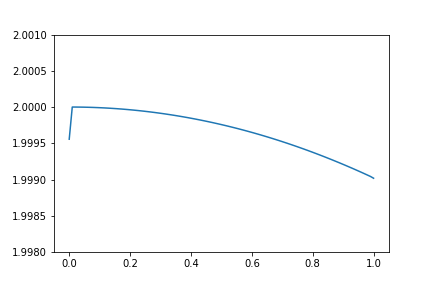

In [118]:
#resultat de l'animation en zoomant sur le haut du pic
top = 2.001
bottom = 1.998

argf = [0]
f = u0
animation2(1,f,argf,top,bottom)

In [16]:
#VF dans le cas pour faire sur groupes de cellules

#calcul du flux a interface i+1/2
def demi(U0,cond):
    #prend en compte les conditions 
    U = np.zeros(len(U0)+3)
    U[2:-1] = U0
    U[:2] = cond[:2]#U0[-1]
    U[-1] = cond[-1]#U0[0]
    #calcule la difference ui -u_i-1 (equivalent de la pente)
    x = U[1:-1] - U[:-2]
    #y = U[2:] - U[1:-1]
    #cond = (x*y>=0)*1
    #sign = cond*2-1
 
    Udemi = U[1:-1] + x/2 #np.minimum(abs(x),abs(y))/2
    return Udemi
 

def demi(U0,cond):
    #prend en compte les conditions 
    U = np.zeros(len(U0)+3)
    U[2:-1] = U0
    U[:2] = cond[:2]#U0[-1]
    U[-1] =cond[-1]
    #calcule la difference ui -u_i-1 (equivalent de la pente)
    x = U[1:-1] - U[:-2]
 
    Udemi = np.zeros(len(U0)+1) 
    Udemi = U[1:-1] + x/2 #np.minimum(abs(x),abs(y))/2
    Udemi = np.minimum(Udemi,np.maximum(np.maximum(U[:-2],U[1:-1]),U[2:]))
    Udemi = np.maximum(Udemi,np.minimum(np.minimum(U[:-2],U[1:-1]),U[2:]))
    return Udemi

#iteration en temps
def VF(U0,dt,dx,c,cond):
    U = U0 #- c*dt/dx/2 * (U0 - np.roll(U0,1))
    U2 = demi(U,cond)
    U = U0 - c*dt/dx * (U2[1:] - U2[:-1])
    return U

In [17]:
def VF2(T,init1):
    #Donnees du pb
    c = 1
    #T = 1
    #Parametres de discretisation
    n_cells = 4
    n_points_cell = 100 + 1
    n_points = n_cells * n_points_cell 
    x = np.linspace(0,1,n_points)
    CFL = 0.4
    dx = x[n_points_cell-1]/(n_points_cell-1)
    dt = dx*CFL/c 
    #Parametres interpolation
    p = 3
    f = u0
    h = 1/n_cells
    epsilon = 1e-5

    #init
    U = np.zeros(n_points)
    U0 = np.zeros(n_points)
    x_temp = np.linspace(0,1, n_points_cell+1) + dx
    for i in range (n_cells) :
        argf = [i] #origine

        d1,d2 = i*n_points_cell, (i+1)*n_points_cell

        if init1==1 : 
            U0[d1:d2] = f(x_temp[:-1],h,*argf)
            name = "Advection by FV with Initialisation by f"
            name1 = "VFInitialisation_by_f"
        else : 
            U0[d1:d2],fx,nb_iter = approxh(x_temp[:-1],p,f,h,argf,epsilon,init=None,s=1)
            name = "Advection by FV with Initialisation by pn"
            name1 = "VFInitialisation_by_pn"
        U = np.copy(U0)
        U_init = np.copy(U)
    #x2 = np.linspace(0,1,n_points)
    #U = f(x2,1,0)
    #U0 = np.copy(U)
    plt.plot(U0)
    plt.show()

    n_iter = int(T//dt)
    #en temp
    for t in range (int(T//dt)):
        for i in range (n_cells) :
            d1,d2 = i*n_points_cell, (i+1)*n_points_cell
            if i == 0 :
                cond = [U0[-2], U0[-1], U0[n_points_cell]]
            elif i == n_cells-1: 
                cond = [U0[d1-2], U0[d1-1], U0[0]]                
            else : 
                cond = [U0[d1-2], U0[d1-1], U0[d2] ]

            U[d1:d2] = VF(U[d1:d2],dt,dx,c,cond)
        U0 = np.copy(U)

        if t % int(n_iter/4) < 1e-4 or t==0 :  
            plt.plot(x+dx,U,label="T="+str(np.round(dt*t,2)))
            plt.plot(x[::n_points_cell]+dx,U[::n_points_cell],'+r')
    plt.legend()
    plt.title(name)
    plt.savefig("./Images/"+name1+"-p"+str(p)+"epsilon"+str(epsilon)+"-T"+str(T)+".eps",format='eps')
    plt.show()
    return x+dx,U,U_init


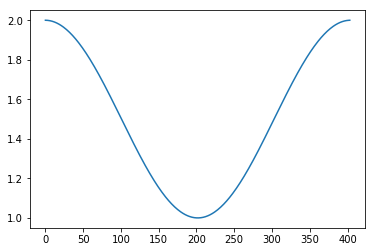

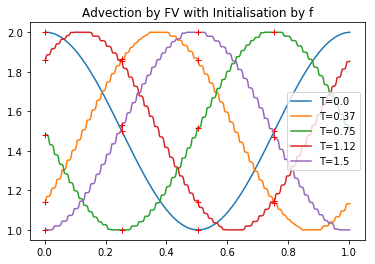

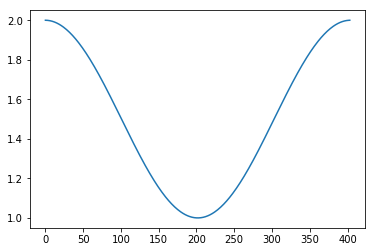

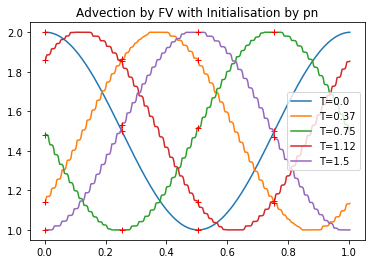

Erreur T=1
0.0180004956909295
0.007932770001681355
0.0008966685586200585
Erreur Init
2.2830130714614193e-07
1.9987669297449884e-08
1.1371616653440378e-08


In [19]:
x,U,Uinit = VF2(1.5,1)
x,U2,Uinit2 = VF2(1.5,2)
Uex = u0(x,1,0)

print("Erreur T=1")
print(npl.norm(U-U2))
print(npl.norm(U-U2,np.inf))
print(trapezes(U-U2,x=x))

print("Erreur Init")
print(npl.norm(Uinit-Uinit2))
print(npl.norm(Uinit-Uinit2,np.inf))
print(trapezes(Uinit-Uinit2,x=x))

In [178]:
import imageio
import os
from IPython.display import HTML
from IPython.display import Image

# Animation
def animation3(init_u,top,bottom):
    #Donnees du pb
    c = 1
    T = 5
    #Parametres de discretisation
    n_cells = 4
    n_points_cell = 100 + 1
    n_points = n_cells * n_points_cell 
    x = np.linspace(0,1,n_points)
    CFL = 1/2*0.9
    dx = x[n_points_cell-1]/(n_points_cell-1)
    dt = dx*CFL/c 
    #Parametres interpolation
    p = 10
    f = u0
    h = 1/n_cells
    epsilon = 1e-5
    
    #init
    U = np.zeros(n_points)
    U0 = np.zeros(n_points)
    x_temp = np.linspace(0,1, n_points_cell+1)
    for i in range (n_cells) :
        argf = [i] #origine
        
        d1,d2 = i*n_points_cell, (i+1)*n_points_cell
    
        if init_u == 0 : 
            U0[d1:d2] = f(x_temp[:-1],h,*argf)
        else : 
            U[d1:d2],fx,nb_iter = approxh(x_temp[:-1],p,f,h,argf,epsilon,init=None,s=1)
        U0 = np.copy(U)

    #x2 = np.linspace(0,1,n_points)
    #U = f(x2,1,0)
    #U0 = np.copy(U)
    plt.plot(U)
    plt.show()
    
    #en temp
    for t in range (int(T//dt)):
        for i in range (n_cells) :
            d1,d2 = i*n_points_cell, (i+1)*n_points_cell
            if i == 0 :
                cond = [U0[-2], U0[-1], U0[n_points_cell]]
            elif i == n_cells-1: 
                cond = [U0[d1-2], U0[d1-1], U0[0]]                
            else : 
                cond = [U0[d1-2], U0[d1-1], U0[d2] ]

            U[d1:d2] = VF(U[d1:d2],dt,dx,c,cond)
        U0 = np.copy(U)
        
        plt.plot(x,U)
        plt.plot(x[::n_points_cell],U[::n_points_cell],'+r')
        plt.ylim(top=top)
        plt.ylim(bottom=bottom)
        plt.savefig("tmp/amont" + str(t) + ".png")
        plt.clf()

        
        
    images = []
    
    for t in range(int(T//dt)):
        images.append(imageio.imread("tmp/amont" + str(t) + ".png"))
    imageio.mimsave('animation_3.gif', images)

    with open('animation_3.gif','rb') as file:
        display(Image(file.read()))
    
    return x,U

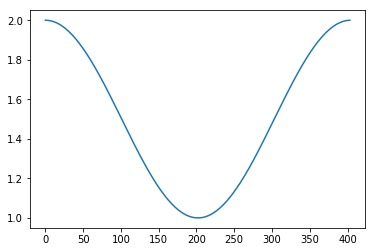

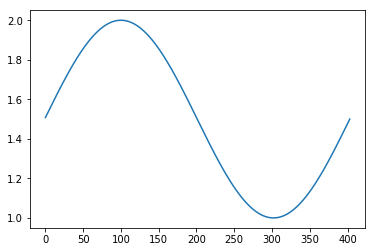

In [ ]:
top = 2.1
bottom = 0.9

x,U = animation3(1,top,bottom)
#animation3(2,top,bottom)


plt.plot(x,U, 'o',label="U (initialized with polynomial)")
#plt.plot(x,Uex,label="exact U")
plt.legend()
plt.savefig("Advection.png",format='png')
plt.show()


<font color='red'>
Devient trop grand
</font>

## <font color='red'>Fin</font>

# D'autres facons - poubelle

In [34]:
from IPython.display import HTML
from IPython.display import Image

# Animation
def animation3(init_u,top,bottom):
    #Donnees du pb
    c = 1
    T = 2
    #Parametres de discretisation
    cells_num = 5
    n_points = 100 + 1
    x = np.linspace(0,1,n_points)
    dx = 1/(n_points-1) 
    CFL = 1/2*0.9
    dt = dx*CFL/c
    #Parametres interpolation
    p = 10
    f = u0
    h = 1/cells_num
    epsilon = 1e-5
    
    #init
    U = np.zeros(cells_num*n_points)
    U0 = np.zeros(cells_num*n_points)
    x_cells = np.zeros(cells_num*n_points)
    for i in range (cells_num) :
        origin = i
        x_cell = (x+origin)*h
        x_cells[i*n_points:(i+1)*n_points] = x_cell
        argf = [origin] 
        if init_u == 0 : 
            U[i*n_points:(i+1)*n_points] = f(x,h,*argf)
        else : 
            U[i*n_points:(i+1)*n_points],fx,nb_iter = approxh(x,p,f,h,argf,epsilon,init=None,s=1)
        U0 = np.copy(U)

    #en temps
    for t in range (int(T//dt)):
        for i in range (cells_num) :
            if i == 0 :
                cond = [U0[-2], U0[-1], U0[n_points+1]]
            elif i == cells_num-1: 
                cond = [U0[i*n_points-3], U0[i*n_points-2], U0[0]]                
            else : 
                cond = [U0[i*n_points-3], U0[i*n_points-2], U0[(i+1)*n_points+1] ]

            U[i*n_points:(i+1)*n_points] = VF(U[i*n_points:(i+1)*n_points],dt,dx,c,cond)
        U0 = np.copy(U)
        
        plt.plot(x_cells,U)
        plt.plot(x_cells[::n_points],U[::n_points],'+r')
        plt.ylim(top=top)
        plt.ylim(bottom=bottom)
        plt.savefig("tmp/amont" + str(t) + ".png")
        plt.clf()

        
        
    images = []

    for t in range(int(T//dt)):
        images.append(imageio.imread("tmp/amont" + str(t) + ".png"))
    imageio.mimsave('animation_3.gif', images)

    with open('animation_3.gif','rb') as file:
        display(Image(file.read()))

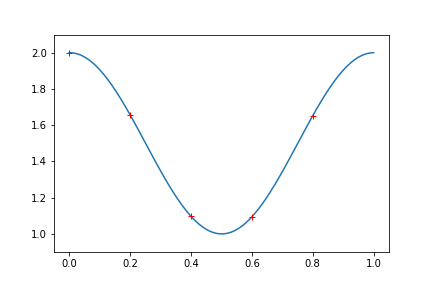

In [35]:
top = 2.1
bottom = 0.9

animation3(0,top,bottom)

### Gros problème a résoudre :
les cellules se chevauchent, pas normal ?

#### Résolu en dessous